In [49]:
import glob

import numpy as np
import pandas as pd
from scipy.spatial.distance import squareform, pdist
from tmap.tda import filter
from tmap.tda.basic import *
import plotly.graph_objs as go
from tmap.netx.SAFE import get_enriched_nodes,construct_node_data

pd.options.display.expand_frame_repr = False
pd.options.display.max_rows= 1000
import scipy.stats as scs
import numpy as np

import warnings
warnings.filterwarnings('ignore')
plotly.offline.init_notebook_mode()

In [23]:
print(plotly.__version__)

2.6.0


In [5]:
def load_otu_data():
    filepath = "AGP_rare1250_s2_Norm_genus.txt"
    data = pd.read_csv(filepath,index_col=0,sep="\t",dtype={"'#OTU ID'":str})
    return data

def load_meta_data():
    filepath = "AGP_metadata_for_ML.csv"
    data = pd.read_csv(filepath,index_col=0,dtype={"sample_name":str})
    return data

def load_dis_data():
    filepath = "unweighted_unifrac.csv"
    data = pd.read_csv(filepath,index_col=0,sep=",",dtype={"samples":str})
    return data

def load_e_dist_data():
    filepath = "AGP_euclidean_dis.csv"
    data = pd.read_csv(filepath,index_col=0,sep=",",dtype={"samples":str})
    return data
# load taxa abundance data, sample metadata and precomputed distance matrix
t1 = time.time()
metadata = load_meta_data()
metadata = metadata.loc[:,metadata.count()>=metadata.shape[0]*0.9]
metadata = metadata.apply(lambda x: x.fillna(np.nanmedian(x)),axis=1)

input_data = load_otu_data().T
input_data = input_data.reindex(metadata.index)
unclassifiy_col = [_ for _ in input_data.columns if _.startswith("unclassfied") and not _.startswith("unclassfied_f")]
input_data = input_data.loc[:,input_data.columns.difference(set(unclassifiy_col))]
input_data = input_data.div(input_data.sum(1),axis=0)

dis = load_dis_data()
euclidean_dis = load_e_dist_data()
dis = dis.reindex(index=metadata.index,columns=metadata.index)
euclidean_dis = euclidean_dis.reindex(index=metadata.index,columns=metadata.index)
print('loading data: ',time.time() -t1)

metadata_category = pd.read_csv('AGP_metadata_category.csv',index_col=0)

loading data:  166.41410374641418


In [6]:
color_codes = {'Anthropometrics': '#88ddcc',
 'Bowel habit': '#ddddee',
 'Dietary habit': '#ffbb66',
 'Genus': 'red',
 'Health': '#4488bb',
 'Health (medication)': '#ff88bb',
 'Life style': '#bbdd66',
 'Sample description': '#999999'}

In [7]:
input_data.shape

(9496, 610)

# Basic tmap analysis(SAFE) + Envfit analysis

In [8]:
graph, graph_name, projected_X = generate_graph(input_data,
                                                dis,
                                                eps_threshold=90,
                                                overlap_params=0.95,
                                                resolution_params=120,
                                                filter_=filter.PCOA,
                                                _eu_dm=euclidean_dis)

Filtering by PCOA.
...calculate distance matrix using the precomputed metric.
Finish filtering of points cloud data.
projection takes:  313.52074456214905
Mapping on data (9496, 610) using lens (9496, 2)
...minimal number of points in hypercube to do clustering: 3


...create 4950 nodes.
...calculate projection coordinates of nodes.
...construct a TDA graph.
...create 41727 edges.
Finish TDA mapping
Graph covers 66.76 percentage of samples.
graph time:  176.40491318702698


In [9]:
node_data = construct_node_data(graph,input_data)
nodes_metadata = construct_node_data(graph,metadata)

In [10]:
dis.to_csv('tmp_un_unifrac_dis.csv',index=True)
metadata.to_csv('tmp_metadata.csv',index=True)

In [11]:
dis.shape,projected_X.shape

((9496, 9496), (9496, 2))

In [12]:
import rpy2.robjects as robjects
from rpy2.robjects.packages import importr

importr("vegan")

envfit_path = 'result/envfit_result.csv'
R_pro_path = 'result/R_pro.csv'
def envfit_metadata(path_data, metadata_path, return_ord=False):
    rcode = """
    dis <- read.csv('{path_data}',row.names = 1)
    metadata <- read.csv('{path_metadata}',row.names = 1,check.names=FALSE)

    ord <- capscale(dis ~ -1)
    #plot(ord)
    """.format(path_data=path_data, path_metadata=metadata_path)
    robjects.r(rcode)

    envfit_result = robjects.r(
        """
        fit <- envfit(ord,metadata,permutations = 999)
        fit$vectors
        """)
    R_ord = robjects.r('summary(ord)$sites')
    R_pro_X_df = pd.DataFrame(data=np.array(R_ord), index=R_ord.rownames, columns=R_ord.colnames)
    fit_result = pd.DataFrame(columns=["r2", "pvals", "Source", "End"], index=envfit_result[envfit_result.names.index("arrows")].rownames)
    fit_result.loc[:, "r2"] = envfit_result[envfit_result.names.index("r")]
    fit_result.loc[:, "pvals"] = envfit_result[envfit_result.names.index("pvals")]
    fit_result.loc[:, ["Source", "End"]] = np.array(envfit_result[envfit_result.names.index("arrows")])
    if return_ord:
        return fit_result, R_pro_X_df
    else:
        return fit_result


import time,os
if not os.path.isfile(envfit_path):
    t1 = time.time()
    fit_result, R_pro_X_df = envfit_metadata('tmp_un_unifrac_dis.csv',
                                             'tmp_metadata.csv',
                                             return_ord=True)
    fit_result.to_csv(envfit_path,index=True)
    R_pro_X_df.to_csv(R_pro_path,index=True)
    print('envfit takes', time.time() - t1)
else:
    fit_result = pd.read_csv(envfit_path,index_col=0)
    R_pro_X_df = pd.read_csv(R_pro_path,index_col=0)


### SAFE analysis (5000 times for genus and metadata)

In [14]:
from tmap.netx.SAFE import SAFE_batch,get_SAFE_summary
from tmap.tda.plot import vis_progressX,Color
n_iter = 5000
safe_scores = SAFE_batch(graph,meta_data = input_data,n_iter=n_iter)


In [15]:
n_iter = 5000
safe_scores_metadata = SAFE_batch(graph,meta_data = metadata,n_iter=n_iter)



In [ ]:
safe_summary = get_SAFE_summary(graph=graph, meta_data=input_data, safe_scores=safe_scores,
                                n_iter_value=n_iter, p_value=0.05)
safe_summary_metadata = get_SAFE_summary(graph=graph, meta_data=metadata, safe_scores=safe_scores_metadata,
                                n_iter_value=n_iter, p_value=0.05)

In [16]:
safe_summary.sort_values('SAFE enriched score',ascending=False).to_csv('result/AGP Genus SAFE summary.csv')

safe_summary_metadata.loc[:,'Category'] = metadata_category.loc[safe_summary_metadata.index,'Category']
safe_summary_metadata.sort_values('SAFE enriched score',ascending=False).to_csv('result/AGP covariate SAFE summary.csv')

In [17]:
safe_scores_total = {**safe_scores_metadata,**safe_scores}
safe_summary_total = pd.concat([safe_summary,safe_summary_metadata],axis=0)

safe_df = pd.DataFrame(safe_scores_total)

#### remove some useless features and assign genus into metadata_category

In [18]:
metadata_category = metadata_category.reindex(safe_df.columns)
metadata_category.loc[metadata_category.index.isin(input_data.columns),'Category'] = 'Genus'

removed_columns = [_ for _ in safe_df.columns if 'Not provided' in _]
safe_df = safe_df.drop(removed_columns,axis=1)
metadata_category = metadata_category.drop(removed_columns,axis=0)

## Ranking comparison between safe and envfit.

In [19]:
compared_table = pd.DataFrame(columns=['SAFE enriched score','R','pval'],
                   index=safe_summary_metadata.sort_values('SAFE enriched score',ascending=False).index)
compared_table.loc[:,'SAFE enriched score'] = list(safe_summary_metadata.sort_values('SAFE enriched score',ascending=False).loc[:,'SAFE enriched score'])
compared_table.loc[:,'R'] = list(fit_result.reindex(safe_summary_metadata.sort_values('SAFE enriched score',ascending=False).index).loc[:,'r2'])
compared_table.loc[:,'pval'] = list(fit_result.reindex(safe_summary_metadata.sort_values('SAFE enriched score',ascending=False).index).loc[:,'pvals'])
compared_table = compared_table.fillna(0)
compared_table.index.name = 'covarites'
compared_table.to_csv('result/Ranking comparison of safe and envfit.csv',index=True)

This is the format of your plot grid:
[ (1,1) x1,y1 ]  [ (1,2) x2,y1 ]



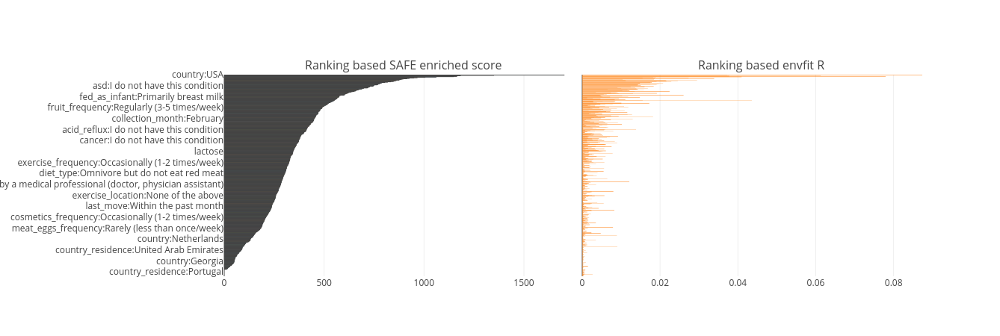

In [50]:
from plotly import tools
import plotly.graph_objs as go
import plotly

fig = tools.make_subplots(1, 2,
                          shared_yaxes=True,
                          horizontal_spacing=0,
                          subplot_titles=['Ranking based SAFE enriched score',
                                          'Ranking based envfit R'])

fig.append_trace(go.Bar(x=compared_table.loc[:,'SAFE enriched score'],
                        y=compared_table.index,
                        marker=dict(color=[color_codes[metadata_category.loc[fea, 'Category']] for fea in compared_table.index],
                                    line=dict(width=1)),
                        orientation='h',
                        showlegend=False), 1, 1)
fig.append_trace(go.Bar(x=compared_table.loc[:, 'R'],
                        y=compared_table.index,
                        orientation='h',
                        showlegend=False), 1, 2)
fig.layout.yaxis.autorange = 'reversed'
fig.layout.margin.l = 300
plotly.offline.iplot(fig, )


## Draw PCoA which is based on SAFE score (For both Metadata and Genus)

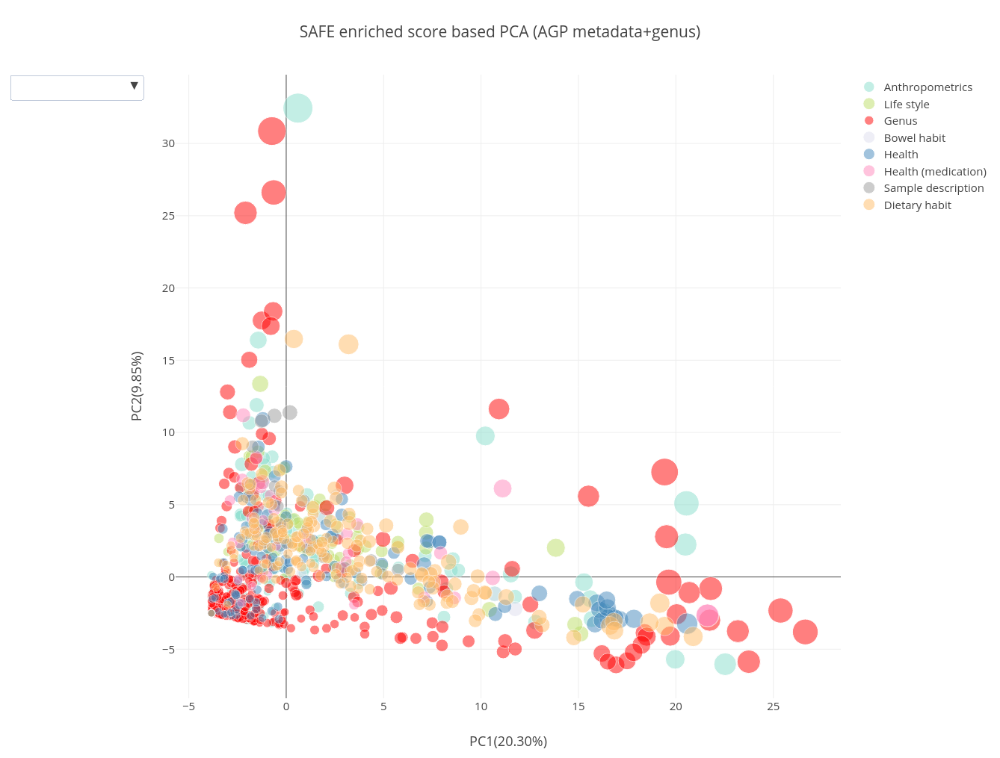

In [51]:
from sklearn.decomposition import PCA
pca = PCA()
pca_result = pca.fit_transform(safe_df.T)

top_metadata = list(safe_summary_metadata.sort_values('SAFE enriched score', ascending=False).index[:10])
top_genus = list(safe_summary.sort_values('SAFE enriched score', ascending=False).index[:10])
mx_scale = MinMaxScaler(feature_range=(10, 40)).fit(safe_summary_total.loc[:, ["SAFE enriched score"]])

data = []
for cat in set(metadata_category.loc[:, 'Category']):
    vals = safe_summary_total.loc[metadata_category.index[metadata_category.Category == cat], ["SAFE enriched score"]]
    data.append(go.Scatter(x=pca_result[metadata_category.Category == cat, 0],
                           y=pca_result[metadata_category.Category == cat, 1],
                           mode="markers",
                           # legendgroup=''
                           name=cat,
                           marker=dict(  color=color_codes[cat],
                               size=mx_scale.transform(vals),
                               opacity=0.5),
                           text=metadata_category.index[metadata_category.Category == cat]))

data.append(go.Scatter(x=pca_result[:,0],
                       y=pca_result[:,1],
                       #visible=False,
                       mode="text",
                       hoverinfo='none',
                       textposition="middle center",
                       name='name for searching',
                       showlegend=False,
                       textfont=dict(size=13),
                        text=''))

traces_index = {trace.name: idx for idx, trace in enumerate(data) if trace['name'] in metadata_category.Category.unique()}
reset_buttons = [dict(args=[{'text':[' ']},{},str(len(data)-1)], label='ClearAll', method='update')]
all_buttons = [dict(args=[{'text':[safe_df.columns]},{},str(len(data)-1)], label='ShowAll', method='update')]

updatemenus = [dict(active=-1,
                    buttons=[dict(args=['text',[_trace.text for _trace in data if _trace.name in traces_index] + [[each if metadata_category.loc[each,'Category'] ==cat else ' ' for each in safe_df.columns]]
                                       ]
                                  , label=cat, method='restyle') for cat in metadata_category.Category.unique().tolist()] + reset_buttons + all_buttons,
                    ),
               ]

layout = dict(xaxis=dict(title="PC1({:.2f}%)".format(pca.explained_variance_ratio_[0] * 100)),
              yaxis=dict(title="PC2({:.2f}%)".format(pca.explained_variance_ratio_[1] * 100)),
              title="SAFE enriched score based PCA (AGP metadata+genus)",
              font=dict(size=15),
              hovermode='closest',
              width=1500,
              height=1000,
              updatemenus=updatemenus)
plotly.offline.plot(dict(data=data,layout=layout),filename="result/fig4d. SAFE enriched score based PCA.html",auto_open=False)
plotly.offline.iplot(dict(data=data,layout=layout))

# Fig.3c pair draw ordination result and tmap graph

In [30]:
scaling_x = list(R_pro_X_df.iloc[:,0] / projected_X[:,0])[0]
scaling_y = list(R_pro_X_df.iloc[:,1] / projected_X[:,1])[0]
fit_result.loc[:,'adj_ratio'] = fit_result.loc[:,'r2'] / max(fit_result.loc[:,'r2'])
fit_result.loc[:,'adj_Source'] = fit_result.Source * fit_result.loc[:,'adj_ratio'] / scaling_x
fit_result.loc[:,'adj_End'] = fit_result.End * fit_result.loc[:,'adj_ratio'] / scaling_y

In [ ]:
from tmap.tda.plot import pair_draw
fea1 = 'race:Asian or Pacific Islander'
fea2 = 'country_residence:China'

fig = pair_draw(pd.concat([input_data,metadata],axis=1),
                projected_X,
                fit_result,
                safe_scores_total,
                graph,
                fea1,
                fea2,)
plotly.offline.plot(fig,filename="result/fig4b.ordination and envfit arrow.html")
#plotly.offline.iplot(fig)

## Coenrichment analysis

In [33]:
from tmap.netx.coenrichment_analysis import *
from tmap.tda.plot import draw_enriched_plot

In [35]:
min_p_value = 1.0 / (n_iter + 1.0)
threshold = np.log10(0.05) / np.log10(min_p_value)
enriched_centroides, enriched_nodes = get_enriched_nodes(pd.DataFrame.from_dict(safe_scores_total, orient='index'), 
                                                         threshold, 
                                                         graph, 
                                                         centroids=True)


In [ ]:
for fea in tqdm(safe_summary_metadata.sort_values('SAFE enriched score',ascending=False).index):
    global_correlative_feas, sub_correlative_feas, metainfo = coenrichment_for_nodes(graph,
                                                                                     enriched_centroides[fea],
                                                                                     fea,
                                                                                     enriched_centroides,
                                                                                    _filter=True,
                                                                                    mode='both')
    global_corr_df, sub_corr_df = construct_correlative_metadata(fea, global_correlative_feas, sub_correlative_feas, metainfo, pd.concat([node_data, 
                                                                                                                                          nodes_metadata],axis=1),verbose=0)
    global_corr_df.loc[global_corr_df.loc[:,'ranksum in co-enriched nodes'] < 0.05,:].sort_values('fisher-exact test pvalue',ascending=True).to_csv('result/coenrichment/%s_global_corr.csv' % fea,index=False)
    sub_corr_df.loc[(sub_corr_df.comps_size >= 10) & (sub_corr_df.loc[:,'coenriched-others pvalue'] < 0.05),:].sort_values(['n_comps','coenriched-others pvalue'],ascending=True).to_csv('result/coenrichment/%s_sub_corr.csv' % fea,index=False)
    draw_enriched_plot(graph,enriched_SAFE_total,fea,metainfo,_filter_size=0,filename='result/coenrichment/%s_comps.html' % fea,auto_open=False)

In [37]:
fe_dis = pairwise_coenrichment(graph,safe_scores_total,_pre_cal_enriched=enriched_centroides)
from statsmodels.sandbox.stats.multicomp import multipletests
corrected_fe_dis = pd.DataFrame(multipletests(fe_dis.values.reshape(-1,), method='fdr_bh')[1].reshape(fe_dis.shape),index=fe_dis.index,columns=fe_dis.columns)

|----------| 0/1293   0% [elapsed: 00:00 left: ?, ? iters/sec]

building network...


In [40]:
import networkx as nx
import itertools
cutoff_ = np.percentile(corrected_fe_dis.values.reshape(-1,1),0.5)
edges = []
for f1,f2 in itertools.combinations(corrected_fe_dis.index,2):
    if fe_dis.loc[f1,f2] <= cutoff_:
        if ('Not provided' not in f1 and 'Not provided' not in f2):
            edges.append((f1,f2,{'weight': 1- fe_dis.loc[f1,f2]}))

In [42]:
G = nx.from_edgelist(edges)
file_path = 'result/test.edges'
nx.write_edgelist(G,file_path,delimiter=';;;')
import pandas as pd
edge_df = pd.read_csv(file_path,sep=';;;',header=None)
edge_df.index = range(edge_df.shape[0])

all_nodes = list(set(list(edge_df.iloc[:,0]) + list(edge_df.iloc[:,1])))
node_df = pd.DataFrame(index=all_nodes,columns=['cat'] )
for idx in range(edge_df.shape[0]):
    source_name = edge_df.iloc[idx,0]
    end_name = edge_df.iloc[idx,1]
    
    edge_df.loc[idx,'weight'] = -np.log(corrected_fe_dis.loc[source_name,end_name]) if not np.isinf(corrected_fe_dis.loc[source_name,end_name]) else 1000
    node_df.loc[source_name,"cat"] = metadata_category.loc[source_name,'Category']
    node_df.loc[end_name,"cat"] = metadata_category.loc[end_name,'Category']
node_df.index.name = 'feature'
edge_df = edge_df.drop([2],axis=1)
edge_df.columns = ['Source','End','weight']
edge_df.to_csv(file_path,index=False,sep='\t')
node_df.to_csv(file_path.replace('edge','node'),sep='\t')

## Stratification with highest SAFE score

In [44]:
safe_score_df = pd.DataFrame.from_dict(safe_scores)
min_p_value = 1.0 / (5000 + 1.0)
threshold = np.log10(0.05) / np.log10(min_p_value)

from collections import Counter
tmp = [safe_score_df.columns[_] if safe_score_df.iloc[idx,_]>=threshold else np.nan for idx,_ in enumerate(np.argmax(safe_score_df.values,axis=1))]
t = Counter(tmp)

In [53]:
node_pos = graph["node_positions"]
nodes = graph["nodes"]
sizes = graph["node_sizes"][:,0]
xs = []
ys = []
for edge in graph["edges"]:
    xs += [node_pos[edge[0], 0],
           node_pos[edge[1], 0],
           None]
    ys += [node_pos[edge[0], 1],
           node_pos[edge[1], 1],
           None]
fig = plotly.tools.make_subplots(1,1)


node_line = go.Scatter(
    # ordination line
    visible=True,
    x=xs,
    y=ys,
    marker=dict(color="#8E9DA2",
                opacity=0.7),
    line=dict(width=1),
    showlegend=False,
    mode="lines")
fig.append_trace(node_line, 1, 1)


for idx,fea in enumerate([_ for _,v in sorted(t.items(),key=lambda x:x[1]) if v >= 100]):
    node_position = go.Scatter(
        # node position
        visible=True,
        x=node_pos[np.array(tmp)==fea, 0],
        y=node_pos[np.array(tmp)==fea, 1],
        hoverinfo="text",
        marker=dict(#color=node_colors,
                    size=[5 + sizes[_] for _ in np.arange(node_pos.shape[0])[np.array(tmp)==fea]],
                    opacity=0.9),
        showlegend=True,
        name = fea + ' (%s)' % str(t[fea]),
        mode="markers")
    fig.append_trace(node_position, 1,1)
fig.layout.width = 1900
fig.layout.height = 1400
fig.layout.font.size= 30
fig.layout.hovermode = 'closest'
plotly.offline.plot(fig,filename="result/Enterotyping-like.html",auto_open=False)


This is the format of your plot grid:
[ (1,1) x1,y1 ]



'file:///home/liaoth/temp_/TDA_big_data/tmp/result/Enterotyping-like.html'

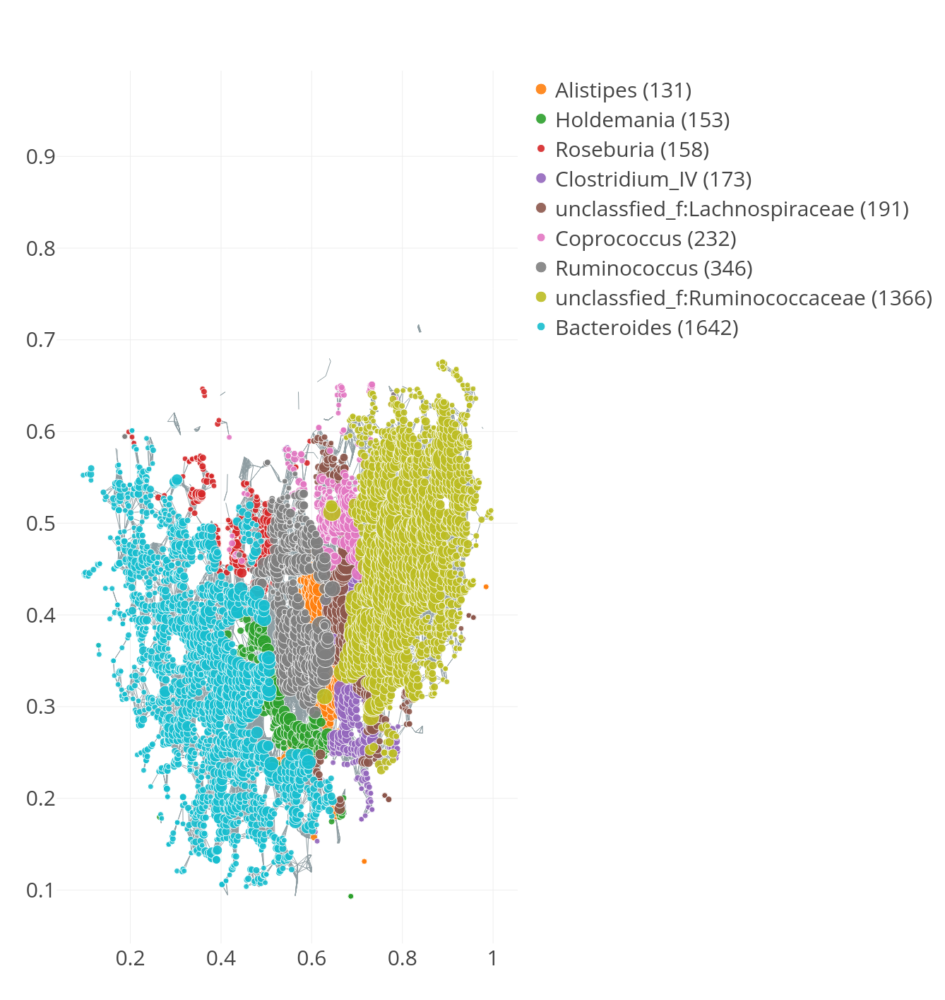

In [54]:
plotly.offline.iplot(fig)

In [47]:
## search highest abundance genera within each stratification
for idx,fea in enumerate([_ for _,v in sorted(t.items(),key=lambda x:x[1]) if v >= 100]):
    print(fea,Counter(node_data.columns[np.argmax(node_data.loc[np.array(tmp)==fea,:].values,1)]))

Alistipes Counter({'Bacteroides': 122, 'Faecalibacterium': 7, 'Alistipes': 1, 'Roseburia': 1})
Holdemania Counter({'Bacteroides': 146, 'Faecalibacterium': 6, 'Akkermansia': 1})
Roseburia Counter({'Bacteroides': 157, 'Faecalibacterium': 1})
Clostridium_IV Counter({'Bacteroides': 171, 'Akkermansia': 2})
unclassfied_f:Lachnospiraceae Counter({'Bacteroides': 177, 'Prevotella': 11, 'Faecalibacterium': 3})
Coprococcus Counter({'Bacteroides': 176, 'Faecalibacterium': 30, 'Prevotella': 25, 'Roseburia': 1})
Ruminococcus Counter({'Bacteroides': 330, 'Faecalibacterium': 15, 'Prevotella': 1})
unclassfied_f:Ruminococcaceae Counter({'Bacteroides': 1159, 'Prevotella': 129, 'Faecalibacterium': 49, 'unclassfied_f:Ruminococcaceae': 12, 'Akkermansia': 5, 'Roseburia': 5, 'unclassfied_f:Lachnospiraceae': 3, 'Alistipes': 3, 'Dialister': 1})
Bacteroides Counter({'Bacteroides': 1639, 'Faecalibacterium': 3})
